## Aula 3 - Análise de dados

### Carregando os dados

In [30]:
import pandas as pd

dados = pd.read_excel("vendas.xlsx")

### Análise exploratória

In [31]:
# verificando as primeiras linhas
dados.head()

,id_pedido,data,loja,cidade,estado,regiao,tamanho,local_consumo,preco,forma_pagamento,ano_mes
0,PED1994,2020-01-01,Loja 4,Santos,São Paulo,Sudeste,300ml,Consumo no local,5,Dinheiro,2020-01
1,PED2246,2020-01-01,Loja 6,Florianópolis,Santa Catarina,Sul,500ml,Consumo no local,11,Débito,2020-01
2,PED3876,2020-01-01,Loja 3,Rio de Janeiro,Rio de Janeiro,Sudeste,300ml,Delivery,7,Crédito,2020-01
3,PED4352,2020-01-01,Loja 1,Fortaleza,Ceará,Nordeste,1000ml,Consumo no local,7,Débito,2020-01
4,PED8633,2020-01-01,Loja 5,São Paulo,São Paulo,Sudeste,200ml,Delivery,9,Crédito,2020-01


In [7]:
# verificando as últimas linhas
dados.tail()

,id_pedido,data,loja,cidade,estado,regiao,tamanho,local_consumo,preco,forma_pagamento,ano_mes
69995,PED67084,2022-12-31,Loja 6,Florianópolis,Santa Catarina,Sul,500ml,Consumo no local,11,Crédito,2022-12
69996,PED67857,2022-12-31,Loja 3,Rio de Janeiro,Rio de Janeiro,Sudeste,200ml,Consumo no local,7,Pix,2022-12
69997,PED69171,2022-12-31,Loja 4,Santos,São Paulo,Sudeste,500ml,Consumo no local,5,Dinheiro,2022-12
69998,PED69229,2022-12-31,Loja 4,Santos,São Paulo,Sudeste,300ml,Consumo no local,9,Pix,2022-12
69999,PED69356,2022-12-31,Loja 1,Fortaleza,Ceará,Nordeste,300ml,Delivery,9,Pix,2022-12


In [36]:
# verificando os tipos de dados
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   id_pedido        70000 non-null  object        
 1   data             70000 non-null  datetime64[ns]
 2   loja             70000 non-null  object        
 3   cidade           70000 non-null  object        
 4   estado           70000 non-null  object        
 5   regiao           70000 non-null  object        
 6   tamanho          70000 non-null  object        
 7   local_consumo    70000 non-null  object        
 8   preco            70000 non-null  int64         
 9   forma_pagamento  70000 non-null  object        
 10  ano_mes          70000 non-null  object        
dtypes: datetime64[ns](1), int64(1), object(9)
memory usage: 5.9+ MB


### Estatísticas

In [34]:
dados.preco.describe().to_frame()

,preco
count,70000.000000
mean,8.355200
std,2.653061
min,5.000000
25%,7.000000
50%,7.000000
75%,11.000000
max,13.000000


### Criando Análises

In [12]:
# puxando o cabeçalho novamente só pra ter uma noção do que vou analisar

dados.head()

,id_pedido,data,loja,cidade,estado,regiao,tamanho,local_consumo,preco,forma_pagamento,ano_mes
0,PED1994,2020-01-01,Loja 4,Santos,São Paulo,Sudeste,300ml,Consumo no local,5,Dinheiro,2020-01
1,PED2246,2020-01-01,Loja 6,Florianópolis,Santa Catarina,Sul,500ml,Consumo no local,11,Débito,2020-01
2,PED3876,2020-01-01,Loja 3,Rio de Janeiro,Rio de Janeiro,Sudeste,300ml,Delivery,7,Crédito,2020-01
3,PED4352,2020-01-01,Loja 1,Fortaleza,Ceará,Nordeste,1000ml,Consumo no local,7,Débito,2020-01
4,PED8633,2020-01-01,Loja 5,São Paulo,São Paulo,Sudeste,200ml,Delivery,9,Crédito,2020-01


#### Quantidade de vendas por loja

In [37]:
# comando para ver as vendas de cada loja
# no caso isso seria o número de linhas de cada
# já que cada linha é uma venda

dados.loja.value_counts().to_frame()

,count
loja,
Loja 4,13483
Loja 6,13075
Loja 1,12344
Loja 5,12177
Loja 3,10603
Loja 2,8318


#### Quantidade de vendas por cidade

In [38]:
dados.cidade.value_counts().to_frame()

,count
cidade,
Santos,13483
Florianópolis,13075
Fortaleza,12344
São Paulo,12177
Rio de Janeiro,10603
Niterói,8318


#### Quantidade de vendas por forma de pagamento

In [39]:
dados.forma_pagamento.value_counts().to_frame()

,count
forma_pagamento,
Crédito,26063
Débito,20427
Dinheiro,14709
Pix,8801


### Faturamento - agrupamento de dados

In [40]:
dados.head()

,id_pedido,data,loja,cidade,estado,regiao,tamanho,local_consumo,preco,forma_pagamento,ano_mes
0,PED1994,2020-01-01,Loja 4,Santos,São Paulo,Sudeste,300ml,Consumo no local,5,Dinheiro,2020-01
1,PED2246,2020-01-01,Loja 6,Florianópolis,Santa Catarina,Sul,500ml,Consumo no local,11,Débito,2020-01
2,PED3876,2020-01-01,Loja 3,Rio de Janeiro,Rio de Janeiro,Sudeste,300ml,Delivery,7,Crédito,2020-01
3,PED4352,2020-01-01,Loja 1,Fortaleza,Ceará,Nordeste,1000ml,Consumo no local,7,Débito,2020-01
4,PED8633,2020-01-01,Loja 5,São Paulo,São Paulo,Sudeste,200ml,Delivery,9,Crédito,2020-01


#### Faturamento por loja


In [41]:
dados.groupby("loja").preco.sum().to_frame()

,preco
loja,
Loja 1,103162
Loja 2,69592
Loja 3,88357
Loja 4,112379
Loja 5,102189
Loja 6,109185


#### Faturamento por estado

In [42]:
# transforma a tabela acima em um arquivo de excel
# que irá ficar salvo na pasta do arquivo do código

dados.groupby(["estado", "cidade", "forma_pagamento"]).preco.sum().to_excel("faturamento.xlsx")

### Visualização de Dados - gráficos e tabelas

In [50]:
!pip install plotly-express

In [52]:
import plotly_express as px

In [53]:
dados.head()

,id_pedido,data,loja,cidade,estado,regiao,tamanho,local_consumo,preco,forma_pagamento,ano_mes
0,PED1994,2020-01-01,Loja 4,Santos,São Paulo,Sudeste,300ml,Consumo no local,5,Dinheiro,2020-01
1,PED2246,2020-01-01,Loja 6,Florianópolis,Santa Catarina,Sul,500ml,Consumo no local,11,Débito,2020-01
2,PED3876,2020-01-01,Loja 3,Rio de Janeiro,Rio de Janeiro,Sudeste,300ml,Delivery,7,Crédito,2020-01
3,PED4352,2020-01-01,Loja 1,Fortaleza,Ceará,Nordeste,1000ml,Consumo no local,7,Débito,2020-01
4,PED8633,2020-01-01,Loja 5,São Paulo,São Paulo,Sudeste,200ml,Delivery,9,Crédito,2020-01


In [65]:
# X é a coluna que eu quero que apareça no eixo de baixo do gráfico

grafico = px.histogram(dados, 
             x="loja", 
             y="preco",
             text_auto=True,
             title = "Faturamento por loja",
             color = "forma_pagamento")

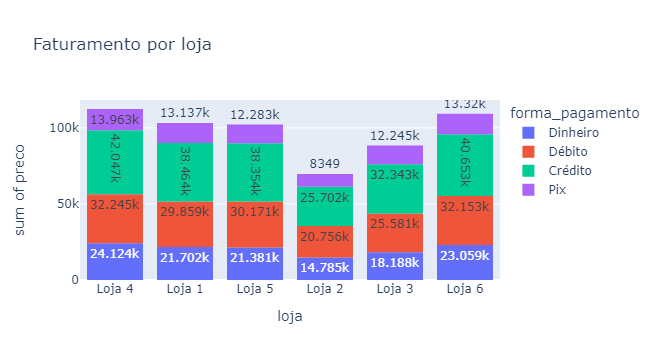

In [67]:
# .show() é para o gráfico aparecer

grafico.show()

In [69]:
# mesma ideia ao salvar o código para o excel
# mas desta vez o arquivo está salvo em html, onde mostra o gráfico

grafico.write_html("grafico-faturamento.html")

In [77]:
colunas = ["loja", "cidade", "estado", "regiao", "local_consumo"]

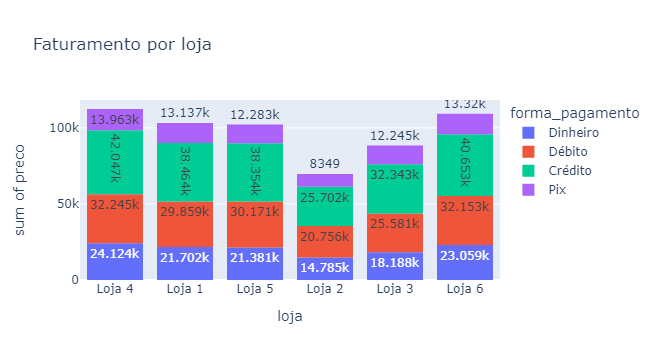

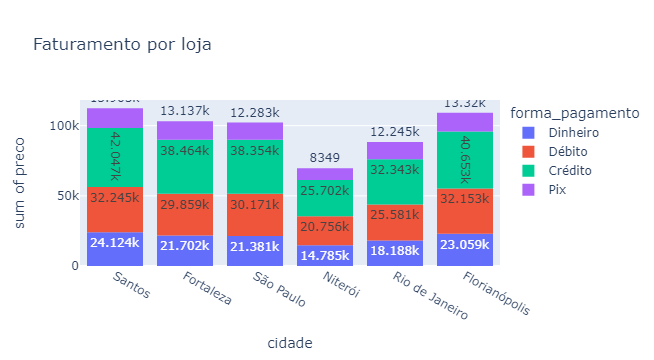

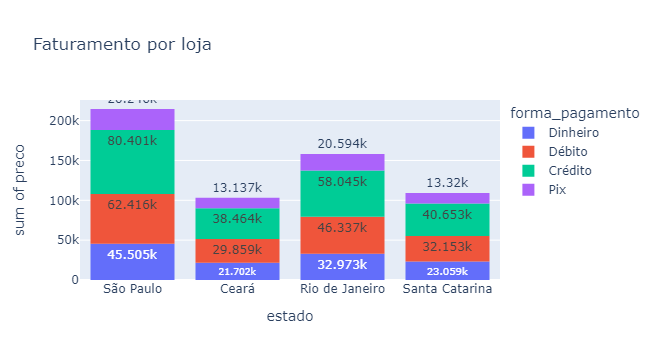

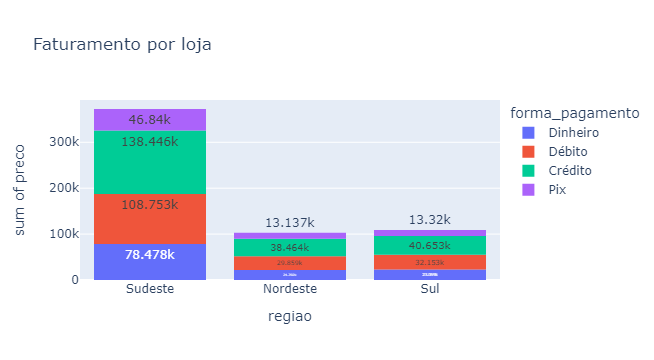

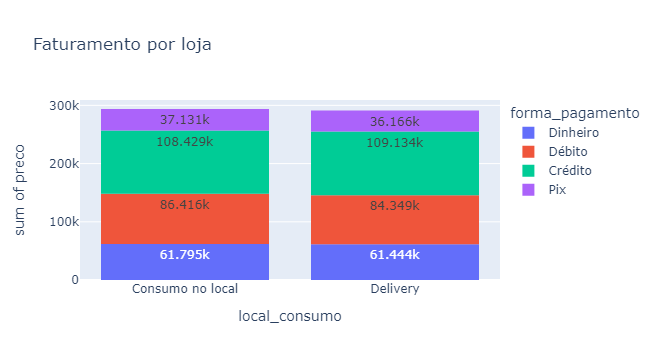

In [80]:
# criação de vários gráficos, salvando-os por html

for coluna in colunas:
    grafico = px.histogram(dados, 
             x=coluna, 
             y="preco",
             text_auto=True,
             title = "Faturamento por loja",
             color = "forma_pagamento")
    grafico.show()
    grafico.write_html(f"grafico-{coluna}.html")

### Lista

In [71]:
convidados = ["Vinicius", "Pedro", "Julia"]

### Estrutura de repetição

In [76]:
# contatenando string com código

for nome in convidados: 
    print(f"Olá {nome}!")

Olá Vinicius!
Olá Pedro!
Olá Julia!
